<a href="https://colab.research.google.com/github/Guweiz-Dy/object-measurement-via-image/blob/main/sizeNew.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
!pip install ultralytics

In [ ]:
import cv2
import ultralytics
import numpy as np

print("OpenCV version:", cv2.__version__)
print("Ultralytics version:", ultralytics.__version__)
print("NumPy version:", np.__version__)


Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
OpenCV version: 4.10.0
Ultralytics version: 8.3.28
NumPy version: 1.26.4



0: 640x480 1 spoon, 4583.3ms
Speed: 5.3ms preprocess, 4583.3ms inference, 1.9ms postprocess per image at shape (1, 3, 640, 480)
Detected Objects: [{'class_name': 'spoon', 'width_in_inches': 1.2276278228995605, 'height_in_inches': 6.145207976115727, 'bounding_box': (1406.24658203125, 881.6981201171875, 1954.0225830078125, 3623.732421875)}]


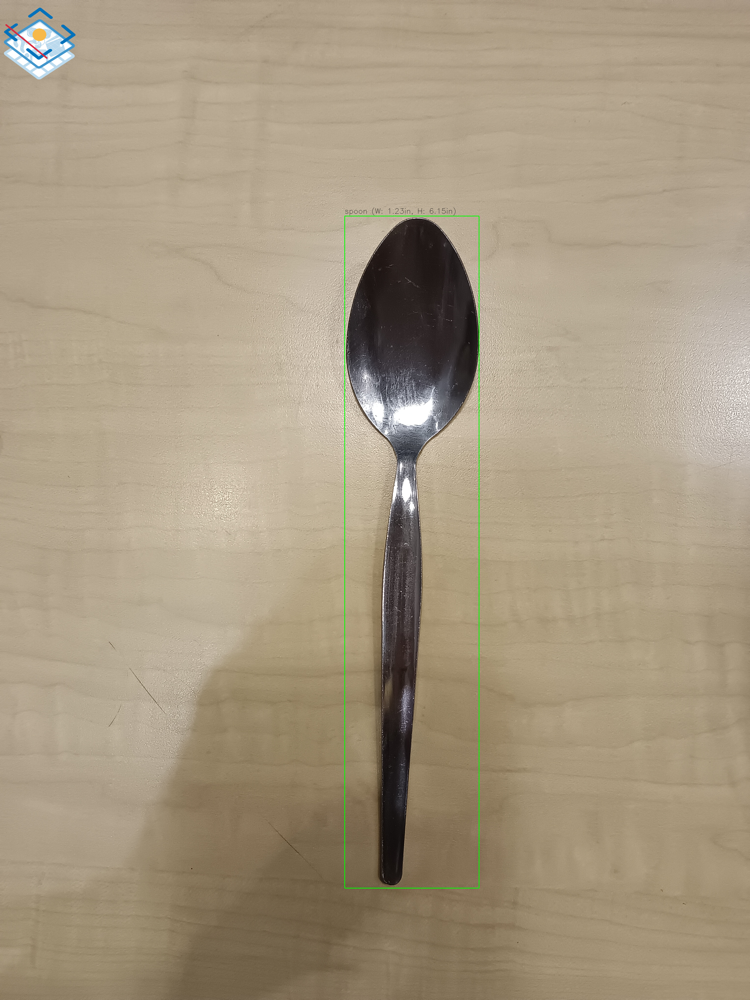

In [ ]:
import cv2
import numpy as np
from ultralytics import YOLO
import os
from google.colab.patches import cv2_imshow

class ObjectDetectionWithLogo:
    def __init__(self, model_path, logo_path):
        self.model = YOLO(model_path)  # Load YOLOv8 model
        self.logo_path = logo_path     # Logo file path
        self.logo = None

        # Load logo
        if os.path.exists(self.logo_path):
            self.logo = cv2.imread(self.logo_path, cv2.IMREAD_UNCHANGED)  # Load with alpha channel if PNG
        else:
            raise FileNotFoundError(f"Logo file not found at {self.logo_path}")

    def find_logo_position(self, image, logo_resized, detected_objects, side='top-left'):
        """Find a position for the logo that doesn't overlap with detected objects."""
        img_h, img_w = image.shape[:2]
        logo_h, logo_w = logo_resized.shape[:2]

        # Start with default position based on chosen side
        if side == 'top-left':
            position = (10, 10)
        elif side == 'top-right':
            position = (img_w - logo_w - 10, 10)
        elif side == 'bottom-left':
            position = (10, img_h - logo_h - 10)
        else:  # 'bottom-right'
            position = (img_w - logo_w - 10, img_h - logo_h - 10)

        # Check for overlaps and adjust position if necessary
        for obj in detected_objects:
            x1, y1, x2, y2 = obj['bounding_box']
            if (position[0] < x2 and position[0] + logo_w > x1 and
                position[1] < y2 and position[1] + logo_h > y1):
                # Move the logo down or to the other corner if there's an overlap
                if side in ['top-left', 'top-right']:
                    position = (position[0], img_h - logo_h - 10)
                else:
                    position = (position[0], 10)
                break

        return position

    def attach_logo(self, image, logo_position=(0, 0), max_logo_width_percentage=0.1):
        """Attach the logo to the top-left corner of the image at a smaller size."""
        # Calculate the maximum logo width based on the image width
        max_logo_width = int(image.shape[1] * max_logo_width_percentage)

        # Resize the logo if it's too large
        logo_width = self.logo.shape[1]
        if logo_width > max_logo_width:
            aspect_ratio = self.logo.shape[1] / self.logo.shape[0]
            new_logo_width = max_logo_width
            logo_resized = cv2.resize(self.logo, (new_logo_width, int(new_logo_width / aspect_ratio)))
        else:
            logo_resized = self.logo.copy()  # Use original logo if it's within limits

        # Get the dimensions of the resized logo
        l_h, l_w = logo_resized.shape[:2]

        # Define the fixed position at the top-left corner
        x_offset, y_offset = logo_position
        y1, y2 = y_offset, y_offset + l_h
        x1, x2 = x_offset, x_offset + l_w

        # Overlay the logo with transparency handling
        if y2 <= image.shape[0] and x2 <= image.shape[1]:
            if logo_resized.shape[2] == 4:  # Check if the logo has an alpha channel
                alpha_logo = logo_resized[:, :, 3] / 255.0  # Alpha channel
                alpha_image = 1.0 - alpha_logo

                for c in range(0, 3):
                    image[y1:y2, x1:x2, c] = (alpha_logo * logo_resized[:, :, c] +
                                              alpha_image * image[y1:y2, x1:x2, c])
            else:
                image[y1:y2, x1:x2] = logo_resized

        return image, logo_resized.shape[1]  # Return the updated image and logo width



    def detect_objects(self, image_with_logo, logo_real_width=5.8):
        """Perform object detection and extract class names, widths, and heights in inches."""
        results = self.model(image_with_logo)
        detected_objects = []

        logo_pixel_width = self.logo.shape[1]
        pixel_per_metric = logo_pixel_width / logo_real_width

        for r in results:
            boxes = r.boxes
            for box in boxes:
                x1, y1, x2, y2 = box.xyxy[0]
                width_in_pixels = (x2 - x1).item()
                height_in_pixels = (y2 - y1).item()
                real_world_width = width_in_pixels / pixel_per_metric
                real_world_height = height_in_pixels / pixel_per_metric

                class_id = int(box.cls[0].item())
                class_name = self.model.names[class_id]

                detected_objects.append({
                    'class_name': class_name,
                    'width_in_inches': real_world_width,
                    'height_in_inches': real_world_height,
                    'bounding_box': (x1.item(), y1.item(), x2.item(), y2.item())
                })

        return detected_objects

    def process_image(self, image_path, logo_position_side='top-left'):
        """Main method to process an image: attach logo, detect objects, and show result."""
        image = cv2.imread(image_path)
        if image is None:
            raise FileNotFoundError(f"Image file not found at {image_path}")

        detected_objects = self.detect_objects(image)

        print("Detected Objects:", detected_objects)

        # Set logo position to the top-left corner
        logo_position = (10, 10)

        image_with_logo, logo_width = self.attach_logo(image, logo_position)

        for obj in detected_objects:
            x1, y1, x2, y2 = obj['bounding_box']
            cv2.rectangle(image_with_logo, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
            cv2.putText(image_with_logo, f"{obj['class_name']} (W: {obj['width_in_inches']:.2f}in, H: {obj['height_in_inches']:.2f}in)",
                        (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 0), 1)

        cv2_imshow(image_with_logo)
        return detected_objects


# Example usage
if __name__ == '__main__':
    model_path = 'yolov8x.pt'
    logo_path = '/content/logo_ret_rev.png'

    detector = ObjectDetectionWithLogo(model_path, logo_path)
    image_path = '/content/spn.jpg'
    detector.process_image(image_path, logo_position_side='top-left')


In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8n.pt')

In [ ]:
model.export(format='tflite')

Ultralytics 8.3.28 🚀 Python-3.10.12 torch-2.5.0+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8n summary (fused): 168 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs

PyTorch: starting from 'yolov8n.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 84, 8400) (6.2 MB)

TensorFlow SavedModel: starting export with tensorflow 2.17.0...

ONNX: starting export with onnx 1.17.0 opset 19...
ONNX: slimming with onnxslim 0.1.36...
ONNX: export success ✅ 1.6s, saved as 'yolov8n.onnx' (12.3 MB)
TensorFlow SavedModel: starting TFLite export with onnx2tf 1.22.3...
TensorFlow SavedModel: export success ✅ 22.9s, saved as 'yolov8n_saved_model' (30.9 MB)

TensorFlow Lite: starting export with tensorflow 2.17.0...
TensorFlow Lite: export success ✅ 0.0s, saved as 'yolov8n_saved_model/yolov8n_float32.tflite' (12.3 MB)

Export complete (23.5s)
Results saved to /content
Predict:         yolo predict task=detect model=yolov8n_saved_model/yolov8n_float32.tflite imgsz=640  
Validate:        yolo va

'yolov8n_saved_model/yolov8n_float32.tflite'

#  **test the tflite model**

WARNING ⚠️ Unable to automatically guess model task, assuming 'task=detect'. Explicitly define task for your model, i.e. 'task=detect', 'segment', 'classify','pose' or 'obb'.
WARNING ⚠️ Unable to automatically guess model task, assuming 'task=detect'. Explicitly define task for your model, i.e. 'task=detect', 'segment', 'classify','pose' or 'obb'.
Loading /content/yolov8n_saved_model/yolov8n_float32.tflite for TensorFlow Lite inference...

0: 640x640 1 remote, 349.8ms
Speed: 17.7ms preprocess, 349.8ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)
Detected Objects: [{'class_name': 'remote', 'width_in_inches': 1.9896557013439433, 'height_in_inches': 8.446262912661805, 'bounding_box': (1002.346923828125, 132.78221130371094, 1890.14501953125, 3901.56298828125)}]


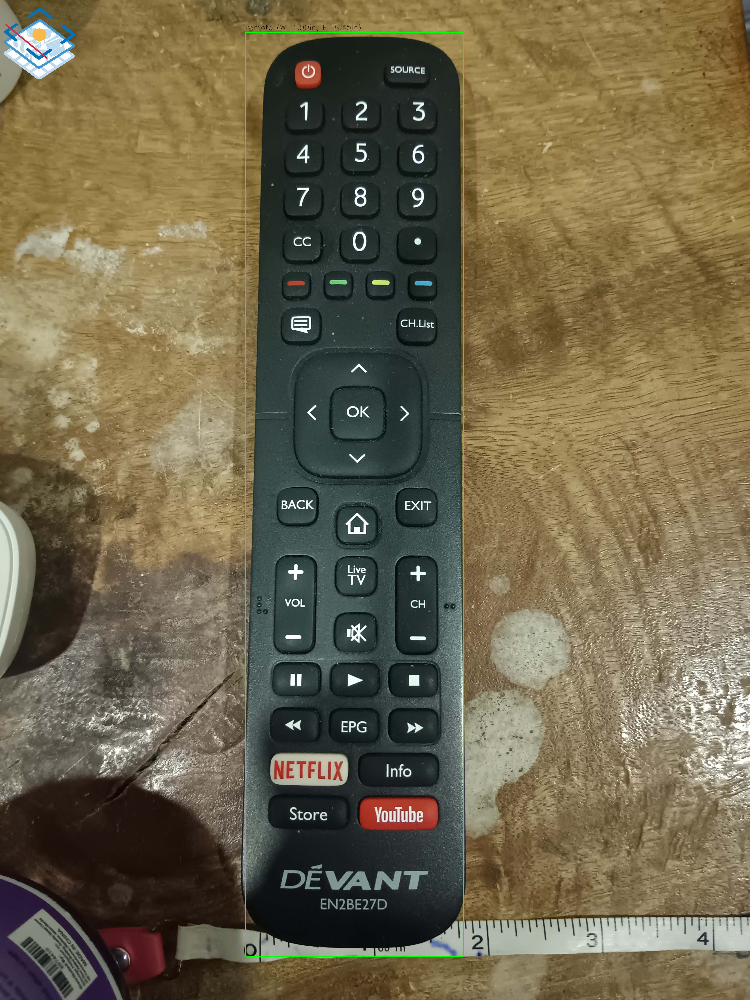

[{'class_name': 'remote',
  'width_in_inches': 1.9896557013439433,
  'height_in_inches': 8.446262912661805,
  'bounding_box': (1002.346923828125,
   132.78221130371094,
   1890.14501953125,
   3901.56298828125)}]

In [ ]:
modeltfl = YOLO('/content/yolov8n_saved_model/yolov8n_float32.tflite')

detector = ObjectDetectionWithLogo(modeltfl.model, logo_path)
image_path_test = '/content/rem.jpg'
detector.process_image(image_path_test, logo_position_side='top-left')

# **rename file**

In [ ]:
import os
os.rename('/content/yolov8n_saved_model/yolov8n_float32.tflite', '/content/dimensionApproximation.tflite')


# test the onnx model

In [ ]:
!pip install onnxruntime opencv-python matplotlib